<a href="https://colab.research.google.com/github/sm-ak-r33/Bias-Detection-SDXL-DPO-Text2Image-Model/blob/main/PathoPulse_Image_Loading.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [39]:
import time
import json
from typing import Dict, Any
from urllib.request import Request, urlopen

def _load_ndpi_properties(image_id: str) -> Dict[str, Any]:
    # Base URL
    url_root = "http://pathogate.net/umbraco/api/IMSPublic/getImageInfo?imageId="
    url = url_root + image_id
    req = Request(url, headers={"User-Agent": "Magic Browser"})

    with urlopen(req) as f:
        s = f.read().decode("UTF8").replace("\\", "")
        info_new = json.loads(s[1:-1])

    print(info_new)
    return info_new


image_id = "135644b8-b608-4a16-bcc9-1b7ba38db320"
info = _load_ndpi_properties(image_id)


{'PixelWidth': '115536', 'PixelHeight': '64929', 'PhysicalWidth': '', 'PhysicalHeight': '', 'Mppx': '0.25190000000000001', 'Mppy': '0.25190000000000001', 'PixelsPrMeter': '3969829.29734021', 'ZStackMin': '', 'ZStackMax': '', 'ZStackLayers': '', 'TileLayersMin': '0', 'TileLayersMax': '17', 'TileLayersNumber': '18', 'Tiles': [[1, 1], [1, 1], [1, 1], [1, 1], [1, 1], [1, 1], [1, 1], [1, 1], [1, 1], [2, 1], [4, 2], [8, 4], [15, 8], [29, 16], [57, 32], [114, 64], [228, 128], [455, 256]], 'Lens': '40', 'Rotation': 180, 'Flipped': False, 'BoundaryX': '10471.0689716691', 'BoundaryY': '2328.29628614361', 'BoundaryW': '22905.9994476175', 'BoundaryH': '61564.1712297907', 'ImageType': 'openslide', 'Path': 'https://openslide.pathogate.net//openslideimages/cba38b5b-1686-48ff-9f87-1e30aa720d72/135644b8-b608-4a16-bcc9-1b7ba38db320/Case08_HE.svs.dzi', 'LocalPath': '/openslideimages/cba38b5b-1686-48ff-9f87-1e30aa720d72/135644b8-b608-4a16-bcc9-1b7ba38db320/Case08_HE.svs', 'FolderId': '60000000-0000-0000-0

In [2]:
image_id = "8070518b-4fdf-4a05-8e8f-69442569aecb"
info = _load_ndpi_properties(image_id)


{'PixelWidth': '21912', 'PixelHeight': '59405', 'PhysicalWidth': '', 'PhysicalHeight': '', 'Mppx': '0.25190000000000001', 'Mppy': '0.25190000000000001', 'PixelsPrMeter': '3969829.29734021', 'ZStackMin': '', 'ZStackMax': '', 'ZStackLayers': '', 'TileLayersMin': '0', 'TileLayersMax': '16', 'TileLayersNumber': '17', 'Tiles': [[1, 1], [1, 1], [1, 1], [1, 1], [1, 1], [1, 1], [1, 1], [1, 1], [1, 1], [1, 2], [2, 4], [3, 8], [6, 15], [11, 30], [22, 59], [44, 117], [87, 234]], 'Lens': '40', 'Rotation': 0, 'Flipped': False, 'BoundaryX': None, 'BoundaryY': None, 'BoundaryW': None, 'BoundaryH': None, 'ImageType': 'openslide', 'Path': 'https://openslide.pathogate.net//openslideimages/cba38b5b-1686-48ff-9f87-1e30aa720d72/8070518b-4fdf-4a05-8e8f-69442569aecb/Case08_HER2.svs.dzi', 'LocalPath': '/openslideimages/cba38b5b-1686-48ff-9f87-1e30aa720d72/8070518b-4fdf-4a05-8e8f-69442569aecb/Case08_HER2.svs', 'FolderId': '60000000-0000-0000-0000-000000000000'}


Time taken: 41.57 seconds


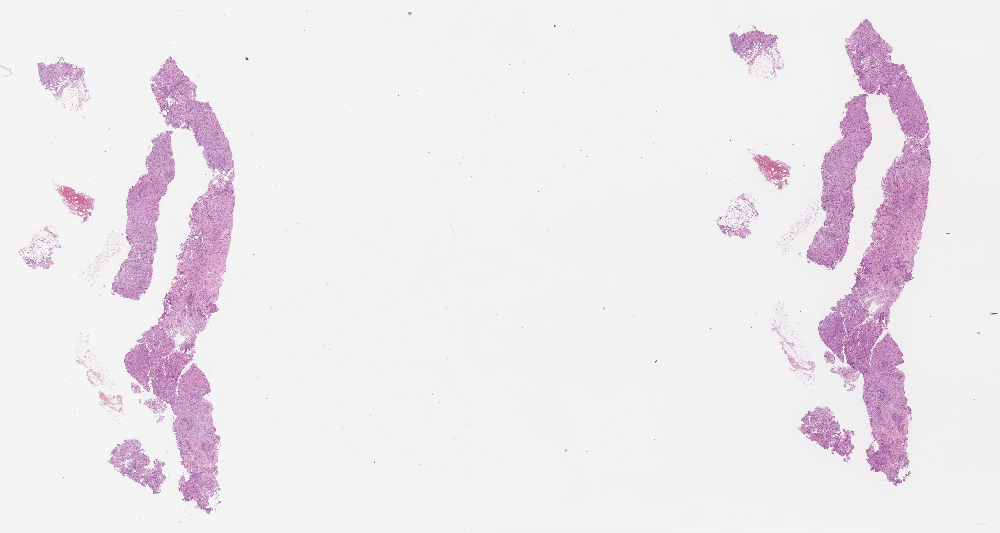

In [7]:
import requests
from PIL import Image
from io import BytesIO
import numpy as np

def fetch_tile(url: str) -> Image.Image:
    """Fetch a tile image from the URL and return it as a PIL Image."""
    try:
        response = requests.get(url)
        response.raise_for_status()
        return Image.open(BytesIO(response.content))
    except Exception as e:
        print(f"Error fetching tile from {url}: {e}")
        return None

def stitch_tiles(tile_urls: list, grid_size: tuple, tile_size: tuple) -> Image.Image:
    """Stitch tiles into a single image."""
    num_rows, num_cols = grid_size
    tile_width, tile_height = tile_size

    # Create a blank canvas for the final stitched image
    stitched_image = Image.new('RGB', ( num_rows * tile_height, num_cols * tile_width))

    for idx, url in enumerate(tile_urls):
        row = idx // num_cols
        col = idx % num_cols

        img = fetch_tile(url)
        if img:
            img = img.resize((tile_width, tile_height))  # Ensure tile is the correct size
            stitched_image.paste(img, ( row *tile_height, col *  tile_width))

    return stitched_image

def generate_tile_urls(base_url: str, zoom_level: int, num_tiles_x: int, num_tiles_y: int) -> list:
    """Generate tile URLs for a given zoom level and grid dimensions."""
    return [f"{base_url}/{zoom_level}/{row}_{col}.jpeg" for row in range(num_tiles_x) for col in range(num_tiles_y)]

# Example parameters
tile_base_url = "https://openslide.pathogate.net/openslideimages/cba38b5b-1686-48ff-9f87-1e30aa720d72/135644b8-b608-4a16-bcc9-1b7ba38db320/Case08_HE.svs_files"
zoom_level = 12
num_tiles_x = 15
num_tiles_y = 8
tile_size = (256, 256)  # Specify the size of each tile

start_time = time.time()
# Generate tile URL
tile_urls = generate_tile_urls(tile_base_url, zoom_level, num_tiles_x, num_tiles_y)
# Stitch tiles into one image
stitched_image = stitch_tiles(tile_urls, (num_tiles_x,num_tiles_y), tile_size)
end_time = time.time()
print(f"Time taken: {end_time - start_time:.2f} seconds")
# Display the final image
stitched_image


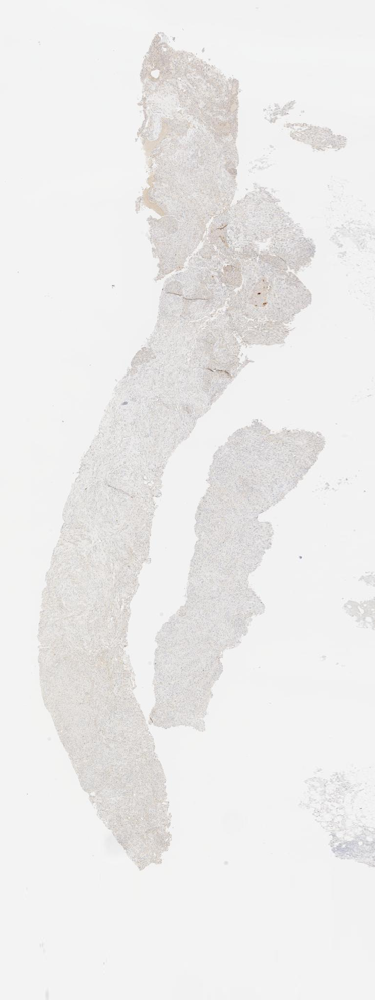

In [8]:
tile_base_url = "https://openslide.pathogate.net/openslideimages/cba38b5b-1686-48ff-9f87-1e30aa720d72/8070518b-4fdf-4a05-8e8f-69442569aecb/Case08_HER2.svs_files/"
zoom_level = 11
num_tiles_x = 3
num_tiles_y = 8
tile_size = (256, 256)  # Specify the size of each tile


# Generate tile URLs
tile_urls = generate_tile_urls(tile_base_url, zoom_level, num_tiles_x, num_tiles_y)

# Stitch tiles into one image
stitched_image = stitch_tiles(tile_urls, (num_tiles_x,num_tiles_y), tile_size)

# Display the final image
stitched_image


# Testing parallel loading with concurrent.futures

---



Time taken: 7.16 seconds


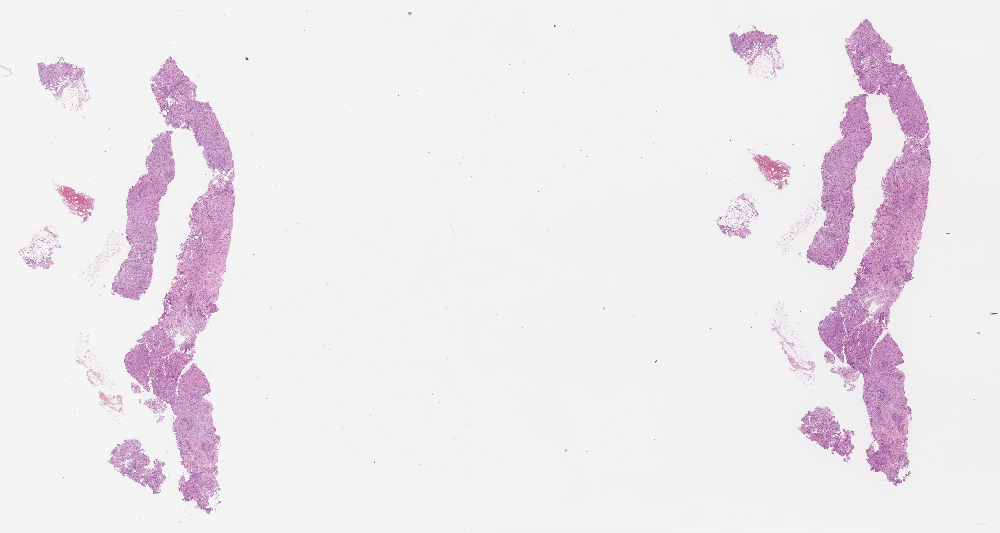

In [9]:
import requests
from PIL import Image
from io import BytesIO
import numpy as np
import concurrent.futures

def fetch_tile(url: str) -> Image.Image:
    """Fetch a tile image from the URL and return it as a PIL Image."""
    try:
        response = requests.get(url)
        response.raise_for_status()
        return Image.open(BytesIO(response.content))
    except Exception as e:
        print(f"Error fetching tile from {url}: {e}")
        return None

def stitch_tiles(tile_urls: list, grid_size: tuple, tile_size: tuple) -> Image.Image:
    """Stitch tiles into a single image."""
    num_rows, num_cols = grid_size
    tile_width, tile_height = tile_size

    # Create a blank canvas for the final stitched image
    stitched_image = Image.new('RGB', ( num_rows * tile_height, num_cols * tile_width))

    # Fetch all tiles in parallel using ThreadPoolExecutor
    with concurrent.futures.ThreadPoolExecutor() as executor:
        images = list(executor.map(fetch_tile, tile_urls))

    for idx, img in enumerate(images):
        row = idx // num_cols
        col = idx % num_cols

        if img:
            img = img.resize((tile_width, tile_height))  # Ensure tile is the correct size
            stitched_image.paste(img, ( row *tile_height, col *  tile_width))

    return stitched_image

def generate_tile_urls(base_url: str, zoom_level: int, num_tiles_x: int, num_tiles_y: int) -> list:
    """Generate tile URLs for a given zoom level and grid dimensions."""
    return [f"{base_url}/{zoom_level}/{row}_{col}.jpeg" for row in range(num_tiles_x) for col in range(num_tiles_y)]

# Example parameters
tile_base_url = "https://openslide.pathogate.net/openslideimages/cba38b5b-1686-48ff-9f87-1e30aa720d72/135644b8-b608-4a16-bcc9-1b7ba38db320/Case08_HE.svs_files"
zoom_level = 12
num_tiles_x = 15
num_tiles_y = 8
tile_size = (256, 256)  # Specify the size of each tile

start_time = time.time()
# Generate tile URL
tile_urls = generate_tile_urls(tile_base_url, zoom_level, num_tiles_x, num_tiles_y)
# Stitch tiles into one image
stitched_image = stitch_tiles(tile_urls, (num_tiles_x,num_tiles_y), tile_size)
end_time = time.time()
print(f"Time taken: {end_time - start_time:.2f} seconds")
# Display the final image
stitched_image

# Testing with asyncio, nest_asyncio

In [10]:
!pip install asyncio
!pip install aiohttp

In [11]:
! pip install nest_asyncio

Time taken: 1.73 seconds


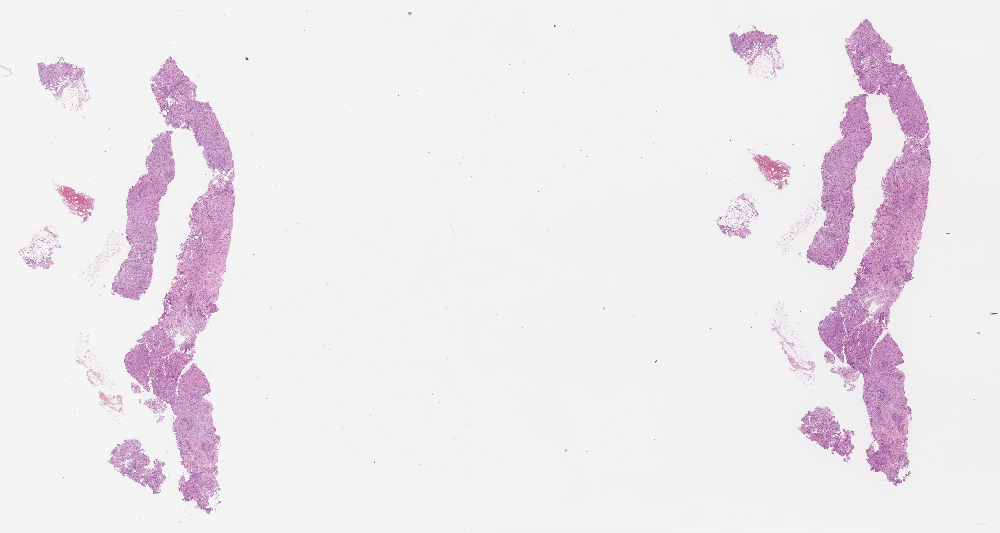

In [48]:
import nest_asyncio
import asyncio
import aiohttp
from PIL import Image
from io import BytesIO

# Apply the patch to allow nested asyncio loops
nest_asyncio.apply()

async def fetch_tile(session: aiohttp.ClientSession, url: str) -> Image.Image:
    """Fetch a tile image asynchronously from the URL and return it as a PIL Image."""
    try:
        async with session.get(url) as response:
            response.raise_for_status()
            data = await response.read()
            return Image.open(BytesIO(data))
    except Exception as e:
        print(f"Error fetching tile from {url}: {e}")
        return None

async def fetch_all_tiles(tile_urls: list) -> list:
    """Fetch all tiles asynchronously."""
    async with aiohttp.ClientSession() as session:
        tasks = [fetch_tile(session, url) for url in tile_urls]
        return await asyncio.gather(*tasks)

def stitch_tiles(tile_urls: list, grid_size: tuple, tile_size: tuple) -> Image.Image:
    """Stitch tiles into a single image."""
    num_rows, num_cols = grid_size
    tile_width, tile_height = tile_size

    # Create a blank canvas for the final stitched image
    stitched_image = Image.new('RGB', (num_rows * tile_height, num_cols * tile_width))

    # Fetch all tiles asynchronously
    images = asyncio.get_event_loop().run_until_complete(fetch_all_tiles(tile_urls))

    for idx, img in enumerate(images):
        row = idx // num_cols
        col = idx % num_cols

        if img:
            img = img.resize((tile_width, tile_height))  # Ensure tile is the correct size
            stitched_image.paste(img, (row * tile_height, col * tile_width))

    return stitched_image

def generate_tile_urls(base_url: str, zoom_level: int, num_tiles_x: int, num_tiles_y: int) -> list:
    """Generate tile URLs for a given zoom level and grid dimensions."""
    return [f"{base_url}/{zoom_level}/{row}_{col}.jpeg" for row in range(num_tiles_x) for col in range(num_tiles_y)]

# Example parameters
tile_base_url = "https://openslide.pathogate.net/openslideimages/cba38b5b-1686-48ff-9f87-1e30aa720d72/135644b8-b608-4a16-bcc9-1b7ba38db320/Case08_HE.svs_files"
zoom_level = 12
num_tiles_x = 15
num_tiles_y = 8
tile_size = (256, 256)  # Specify the size of each tile

start_time = time.time()
# Generate tile URL
tile_urls = generate_tile_urls(tile_base_url, zoom_level, num_tiles_x, num_tiles_y)
# Stitch tiles into one image
stitched_image = stitch_tiles(tile_urls, (num_tiles_x,num_tiles_y), tile_size)
end_time = time.time()
print(f"Time taken: {end_time - start_time:.2f} seconds")
# Display the final image
stitched_image

# Testing with httpx

In [13]:
! pip install httpx

Time taken: 2.41 seconds


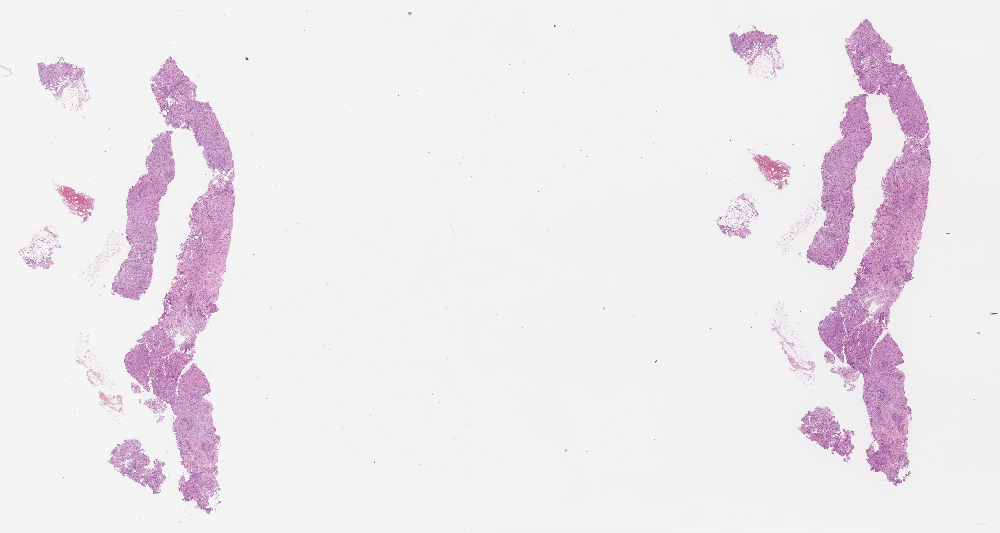

In [14]:
import asyncio
import httpx
from PIL import Image
from io import BytesIO
import nest_asyncio

# Apply the patch to allow nested asyncio loops
nest_asyncio.apply()

async def fetch_tile(client: httpx.AsyncClient, url: str) -> Image.Image:
    """Fetch a tile image asynchronously from the URL and return it as a PIL Image."""
    try:
        response = await client.get(url)
        response.raise_for_status()
        return Image.open(BytesIO(response.content))
    except Exception as e:
        print(f"Error fetching tile from {url}: {e}")
        return None

async def fetch_all_tiles(tile_urls: list) -> list:
    """Fetch all tiles asynchronously."""
    async with httpx.AsyncClient() as client:
        tasks = [fetch_tile(client, url) for url in tile_urls]
        return await asyncio.gather(*tasks)

def stitch_tiles(tile_urls: list, grid_size: tuple, tile_size: tuple) -> Image.Image:
    """Stitch tiles into a single image."""
    num_rows, num_cols = grid_size
    tile_width, tile_height = tile_size

    # Create a blank canvas for the final stitched image
    stitched_image = Image.new('RGB', (num_rows * tile_height, num_cols * tile_width))

    # Fetch all tiles asynchronously
    images = asyncio.get_event_loop().run_until_complete(fetch_all_tiles(tile_urls))

    for idx, img in enumerate(images):
        row = idx // num_cols
        col = idx % num_cols

        if img:
            img = img.resize((tile_width, tile_height))  # Ensure tile is the correct size
            stitched_image.paste(img, (row * tile_height, col * tile_width))

    return stitched_image

def generate_tile_urls(base_url: str, zoom_level: int, num_tiles_x: int, num_tiles_y: int) -> list:
    """Generate tile URLs for a given zoom level and grid dimensions."""
    return [f"{base_url}/{zoom_level}/{row}_{col}.jpeg" for row in range(num_tiles_x) for col in range(num_tiles_y)]

# Example parameters
tile_base_url = "https://openslide.pathogate.net/openslideimages/cba38b5b-1686-48ff-9f87-1e30aa720d72/135644b8-b608-4a16-bcc9-1b7ba38db320/Case08_HE.svs_files"
zoom_level = 12
num_tiles_x = 15
num_tiles_y = 8
tile_size = (256, 256)  # Specify the size of each tile

start_time = time.time()
# Generate tile URL
tile_urls = generate_tile_urls(tile_base_url, zoom_level, num_tiles_x, num_tiles_y)
# Stitch tiles into one image
stitched_image = stitch_tiles(tile_urls, (num_tiles_x,num_tiles_y), tile_size)
end_time = time.time()
print(f"Time taken: {end_time - start_time:.2f} seconds")
# Display the final image
stitched_image

# Testing with requests_futures

In [15]:
!pip install requests_futures

Time taken: 16.89 seconds


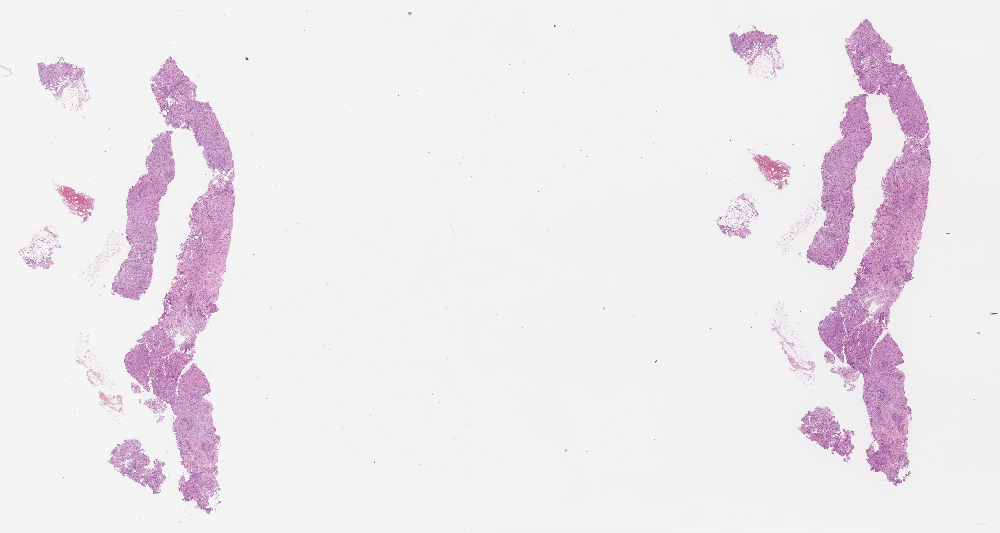

In [16]:
from requests_futures.sessions import FuturesSession
from PIL import Image
from io import BytesIO

def fetch_tile(session: FuturesSession, url: str) -> Image.Image:
    """Fetch a tile image from the URL and return it as a PIL Image."""
    try:
        future = session.get(url)
        response = future.result()
        response.raise_for_status()
        return Image.open(BytesIO(response.content))
    except Exception as e:
        print(f"Error fetching tile from {url}: {e}")
        return None

def stitch_tiles(tile_urls: list, grid_size: tuple, tile_size: tuple) -> Image.Image:
    """Stitch tiles into a single image."""
    num_rows, num_cols = grid_size
    tile_width, tile_height = tile_size

    # Create a blank canvas for the final stitched image
    stitched_image = Image.new('RGB', (num_rows * tile_height, num_cols * tile_width))

    # Use FuturesSession for asynchronous requests
    session = FuturesSession()
    images = [fetch_tile(session, url) for url in tile_urls]

    for idx, img in enumerate(images):
        row = idx // num_cols
        col = idx % num_cols

        if img:
            img = img.resize((tile_width, tile_height))  # Ensure tile is the correct size
            stitched_image.paste(img, (row * tile_height, col * tile_width))

    return stitched_image

def generate_tile_urls(base_url: str, zoom_level: int, num_tiles_x: int, num_tiles_y: int) -> list:
    """Generate tile URLs for a given zoom level and grid dimensions."""
    return [f"{base_url}/{zoom_level}/{row}_{col}.jpeg" for row in range(num_tiles_x) for col in range(num_tiles_y)]

# Example parameters
tile_base_url = "https://openslide.pathogate.net/openslideimages/cba38b5b-1686-48ff-9f87-1e30aa720d72/135644b8-b608-4a16-bcc9-1b7ba38db320/Case08_HE.svs_files"
zoom_level = 12
num_tiles_x = 15
num_tiles_y = 8
tile_size = (256, 256)  # Specify the size of each tile

start_time = time.time()
# Generate tile URL
tile_urls = generate_tile_urls(tile_base_url, zoom_level, num_tiles_x, num_tiles_y)
# Stitch tiles into one image
stitched_image = stitch_tiles(tile_urls, (num_tiles_x,num_tiles_y), tile_size)
end_time = time.time()
print(f"Time taken: {end_time - start_time:.2f} seconds")
# Display the final image
stitched_image

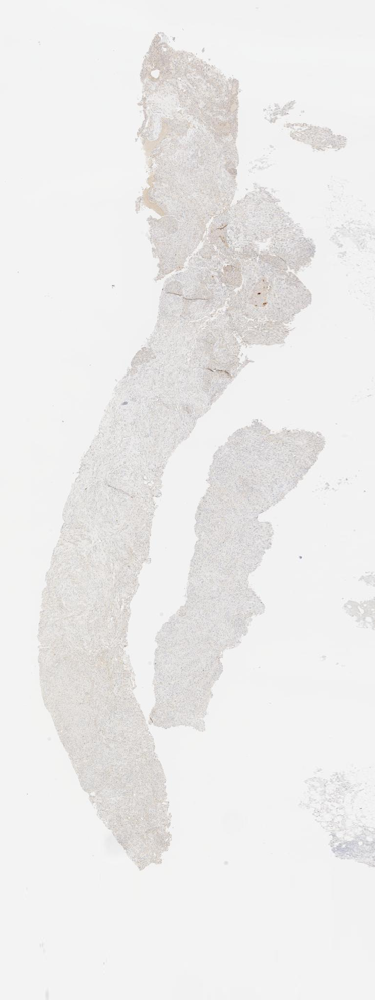

In [20]:
tile_base_url = "https://openslide.pathogate.net/openslideimages/cba38b5b-1686-48ff-9f87-1e30aa720d72/8070518b-4fdf-4a05-8e8f-69442569aecb/Case08_HER2.svs_files/"
zoom_level = 11
num_tiles_x = 3
num_tiles_y = 8
tile_size = (256, 256)  # Specify the size of each tile


# Generate tile URLs
tile_urls = generate_tile_urls(tile_base_url, zoom_level, num_tiles_x, num_tiles_y)

# Stitch tiles into one image
stitched_image = stitch_tiles(tile_urls, (num_tiles_x,num_tiles_y), tile_size)

# Display the final image
stitched_image

In [22]:
stitched_image.size

(768, 2048)

Selected Zoom Level: 13
Number of tiles (X, Y): (29, 16)


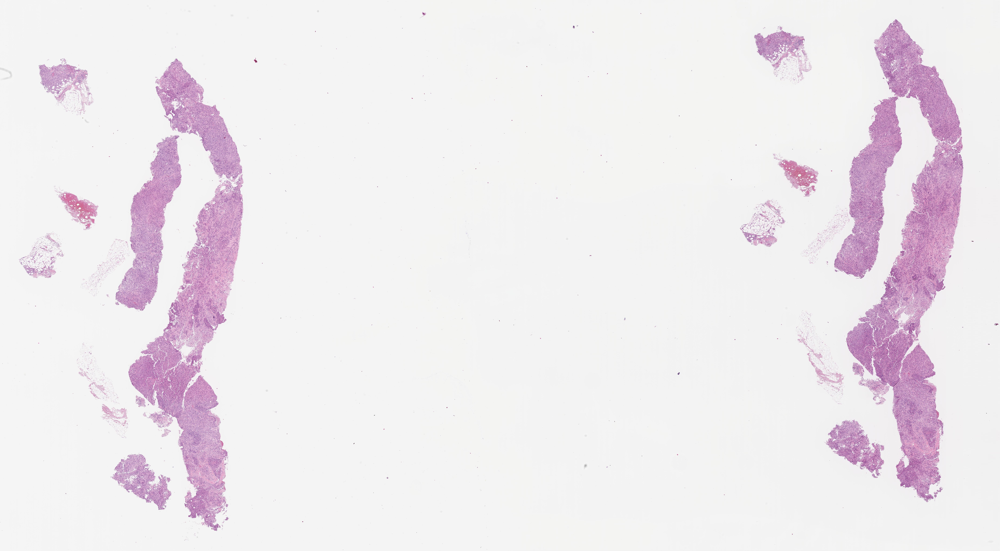

In [50]:
def select_zoom_level(max_resolution: int, info: Dict[str, Any]) -> int:
    pixel_width_max = int(info['PixelWidth'])
    num_zoom_levels = int(info['TileLayersNumber'])  # Total number of zoom levels

    # Iterate from highest zoom level to lowest, looking for the one that fits within max_resolution
    for i in range(num_zoom_levels - 1, -1, -1):
        current_width = pixel_width_max / (2 ** (num_zoom_levels - 1 - i))
        if current_width <= max_resolution:
            return i  # Return the highest zoom level that fits within the max resolution

    return 0  # Return the lowest resolution if none fits

def get_tile_count_for_zoom_level(zoom_level: int, info: Dict[str, Any]) -> tuple:
    # Extract tile counts from the 'Tiles' list for the selected zoom level
    num_tiles_x, num_tiles_y = info['Tiles'][zoom_level]
    return num_tiles_x, num_tiles_y

# Example usage
max_x_resolution = 10000  # Replace with your desired maximum resolution
zoom_level = select_zoom_level(max_x_resolution, info)
print(f"Selected Zoom Level: {zoom_level}")

# Automatically determine the number of tiles based on the zoom level
num_tiles_x, num_tiles_y = get_tile_count_for_zoom_level(zoom_level, info)
print(f"Number of tiles (X, Y): ({num_tiles_x}, {num_tiles_y})")

# Generate tile URL
tile_urls = generate_tile_urls(tile_base_url, zoom_level, num_tiles_x, num_tiles_y)
# Stitch tiles into one image
stitched_image = stitch_tiles(tile_urls, (num_tiles_x, num_tiles_y), tile_size)
stitched_image
